In [1]:
import os

import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

from mtist import master_dataset_generation as mdg
from mtist import assemble_mtist as am
from mtist import mtist_utils as mu
from mtist import infer_mtist as im

%config InlineBackend.figure_format='retina'
%load_ext autoreload
%autoreload 2

In [2]:
def easy_subplots(ncols=1, nrows=1, base_figsize=None, **kwargs):

    if base_figsize is None:
        base_figsize = (8, 5)

    fig, axes = plt.subplots(
        ncols=ncols,
        nrows=nrows,
        figsize=(base_figsize[0] * ncols, base_figsize[1] * nrows),
        **kwargs
    )

    # Lazy way of doing this
    try:
        axes = axes.reshape(-1)
    except:
        pass

    return fig, axes

/Users/granthussey/github/updated_mtist/mtist_platform/mtist/graphing_utils.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(


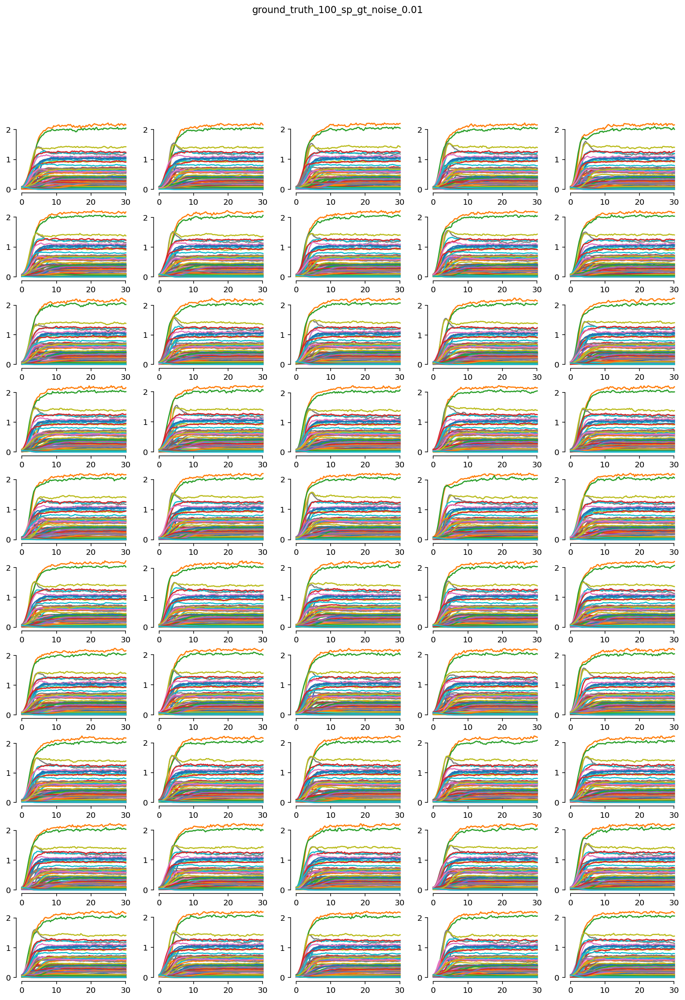

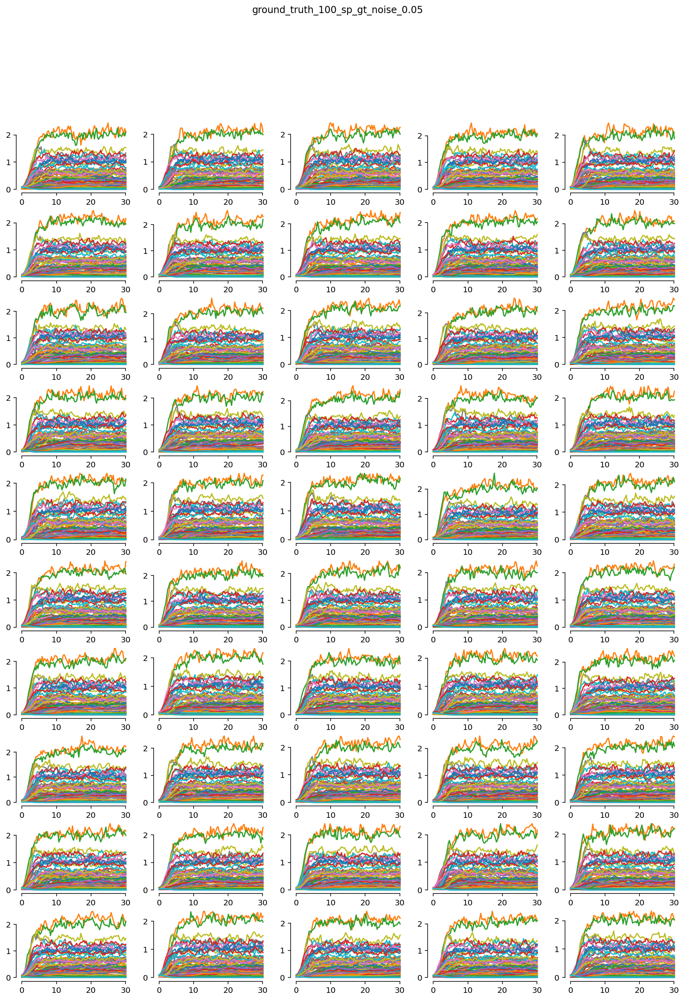

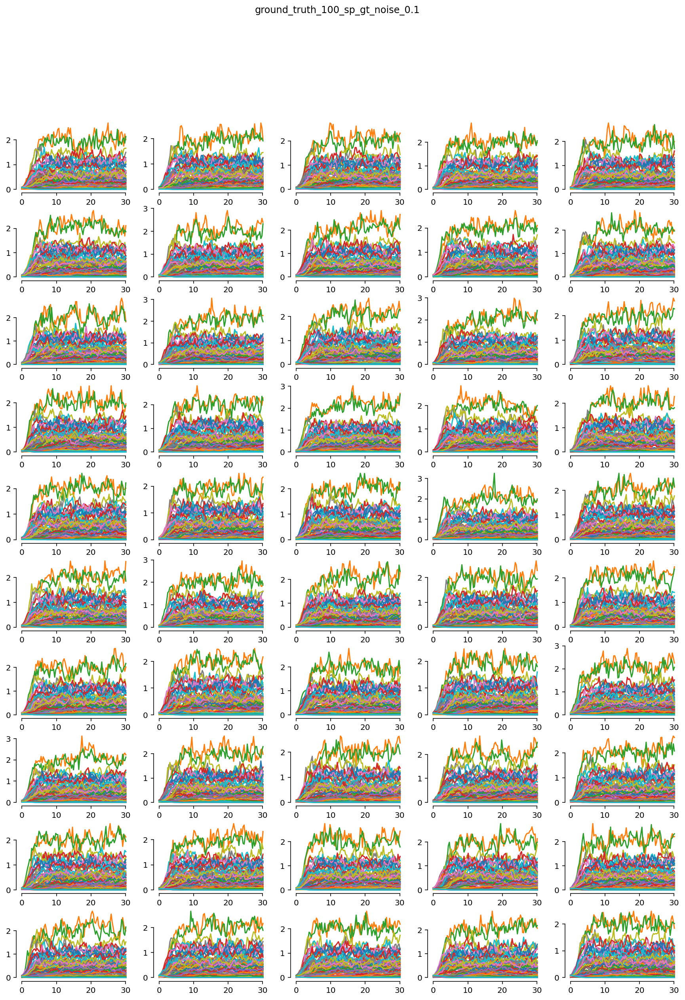

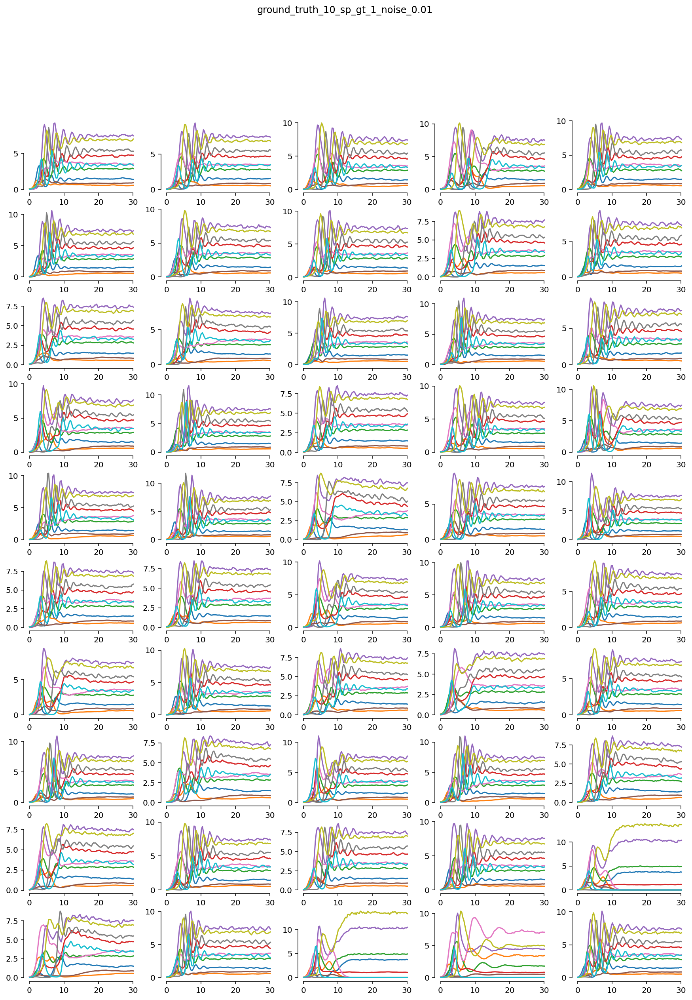

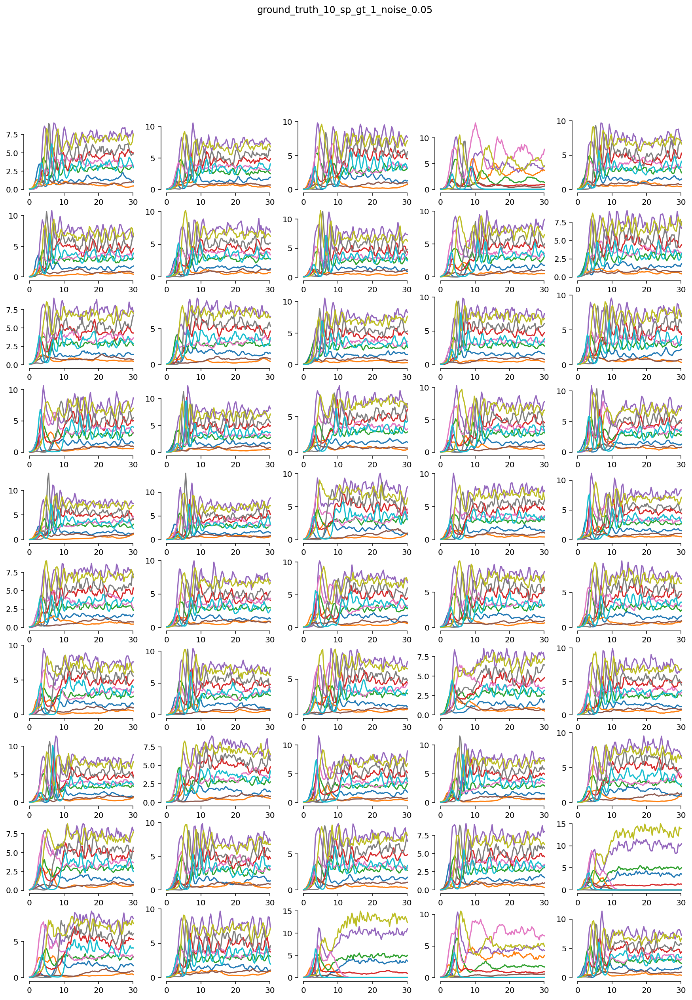

...

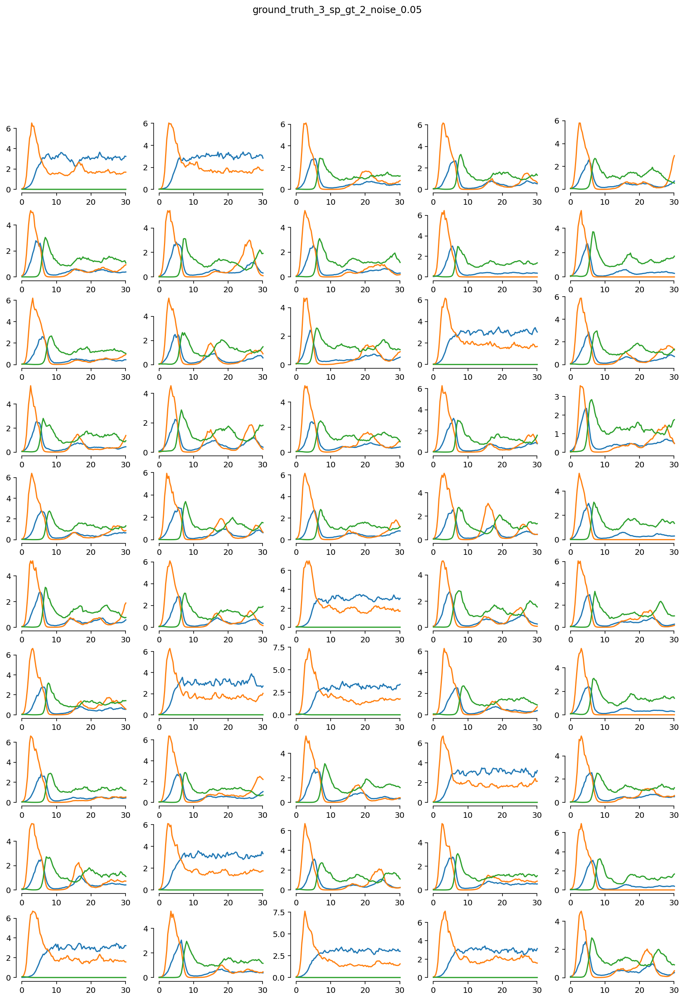

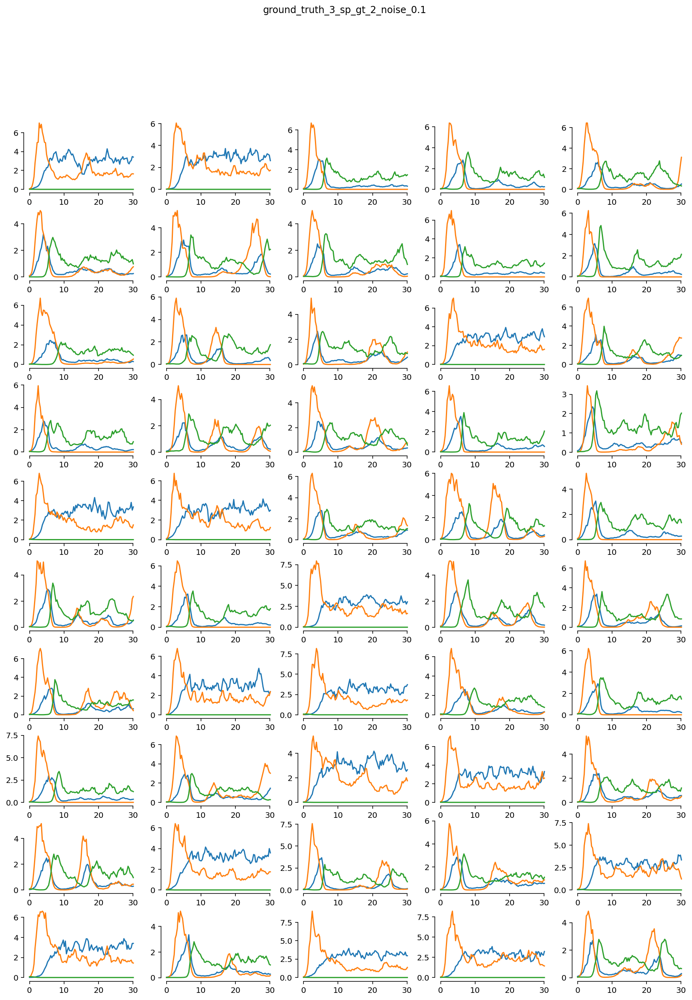

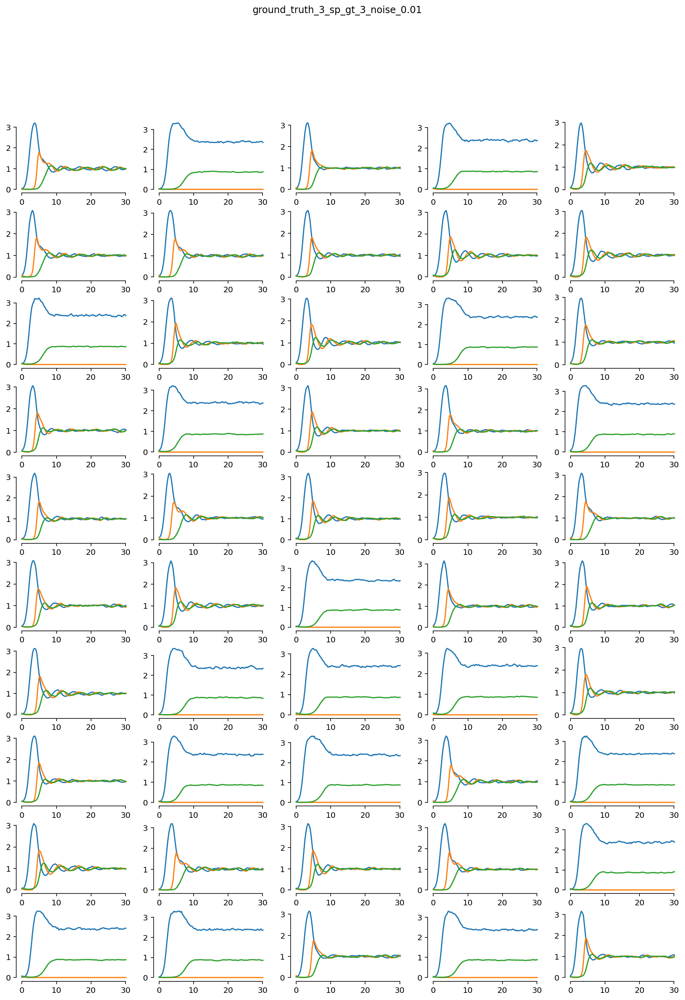

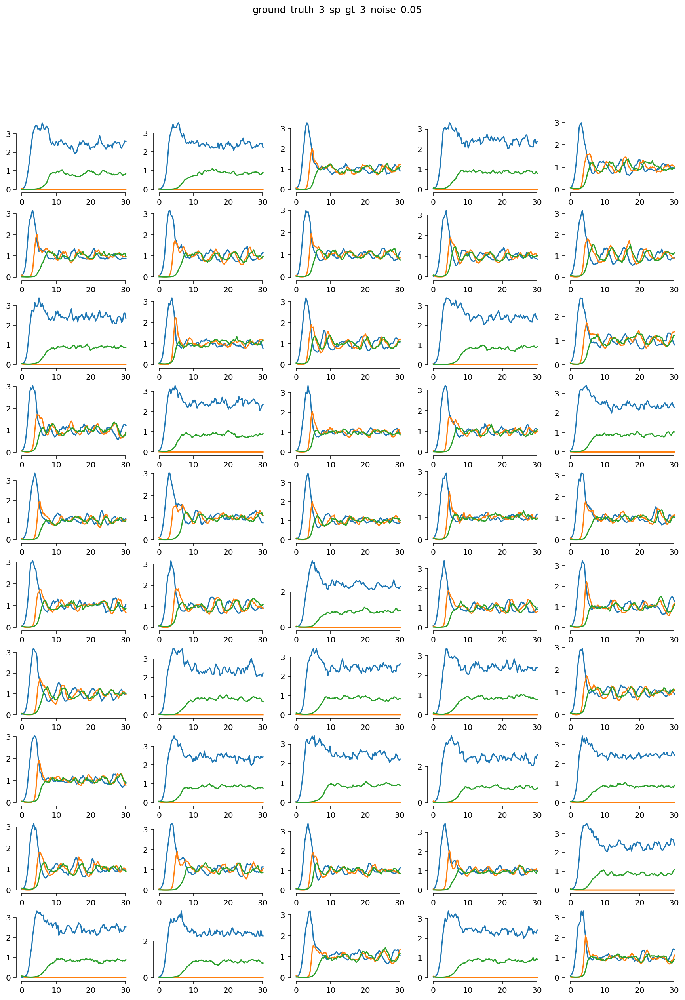

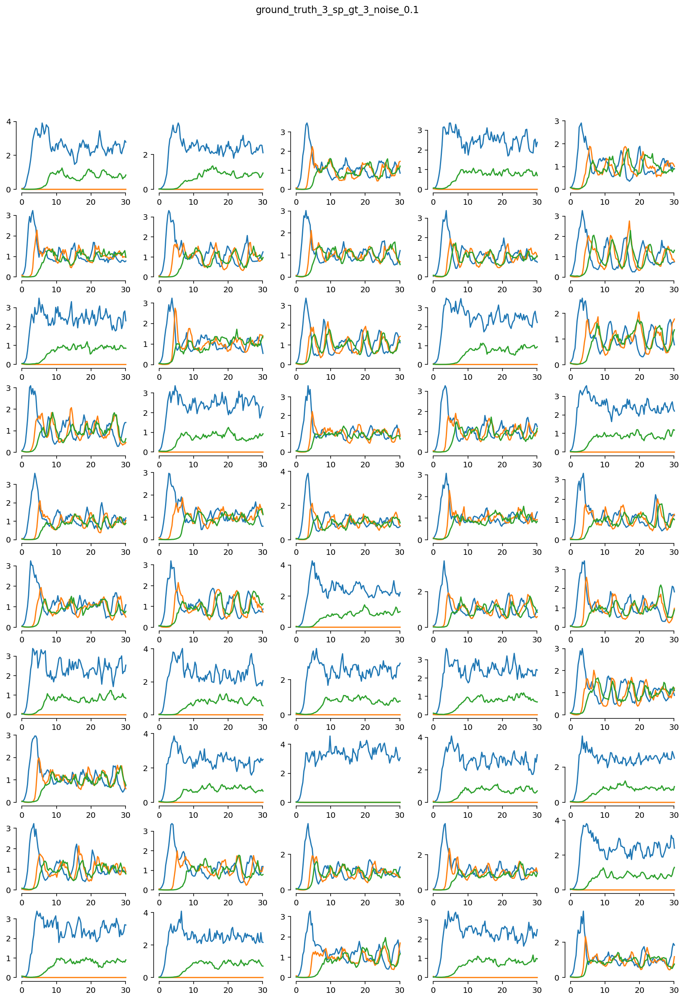

In [3]:
mdg.generate_mtist_master_datasets()
am.assemble_mtist()

df_es_scores, inferred_aijs = im.infer_and_score_all()

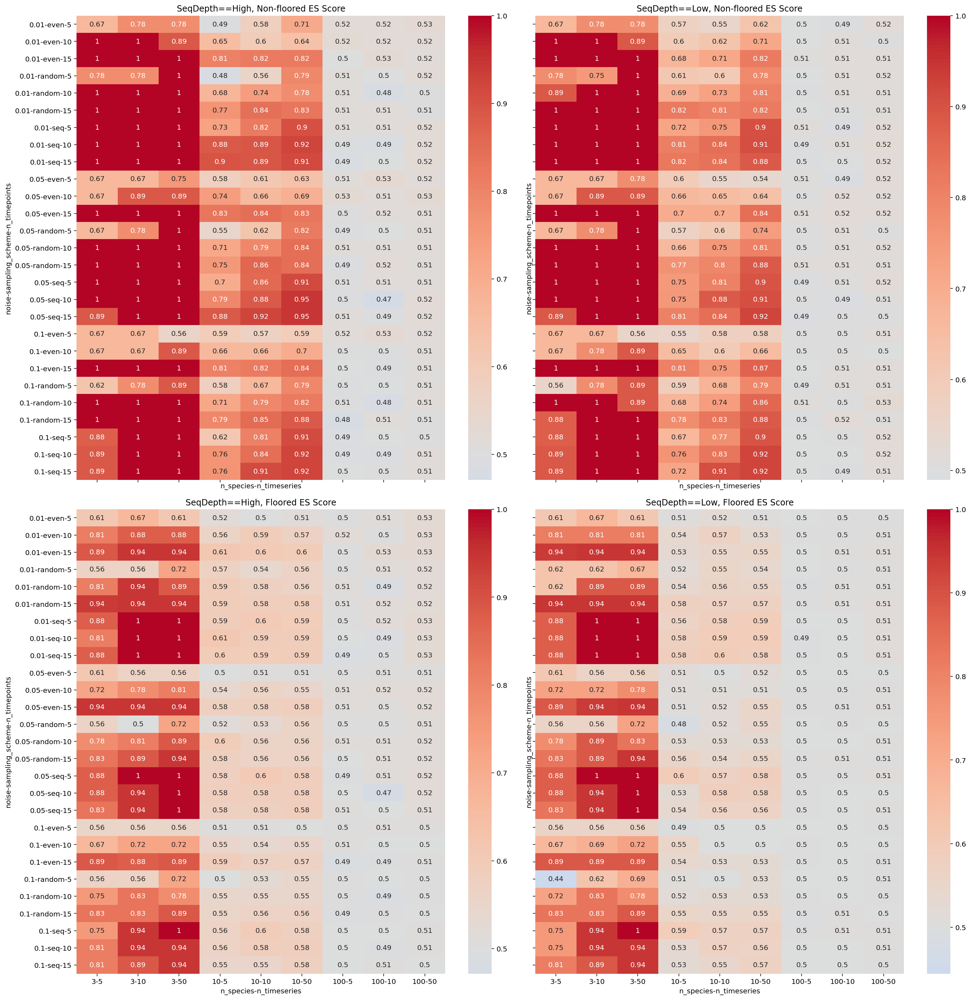

In [4]:
meta = am.generate_metadata().set_index("did")

# Get heatmaps across seq_depth low, high and raw, floored scores

hm_high_raw = (
    df_es_scores.join(meta)
    .query('seq_depth == "high"')
    .groupby(["n_species", "noise", "n_timeseries", "sampling_scheme", "n_timepoints"])
    .median()
    .pivot_table(
        index=["noise", "sampling_scheme", "n_timepoints"],
        columns=["n_species", "n_timeseries"],
        values="raw",
    )
)

hm_low_raw = (
    df_es_scores.join(meta)
    .query('seq_depth == "low"')
    .groupby(["n_species", "noise", "n_timeseries", "sampling_scheme", "n_timepoints"])
    .median()
    .pivot_table(
        index=["noise", "sampling_scheme", "n_timepoints"],
        columns=["n_species", "n_timeseries"],
        values="raw",
    )
)

hm_high_floored = (
    df_es_scores.join(meta)
    .query('seq_depth == "high"')
    .groupby(["n_species", "noise", "n_timeseries", "sampling_scheme", "n_timepoints"])
    .median()
    .pivot_table(
        index=["noise", "sampling_scheme", "n_timepoints"],
        columns=["n_species", "n_timeseries"],
        values="floored",
    )
)

hm_low_floored = (
    df_es_scores.join(meta)
    .query('seq_depth == "low"')
    .groupby(["n_species", "noise", "n_timeseries", "sampling_scheme", "n_timepoints"])
    .median()
    .pivot_table(
        index=["noise", "sampling_scheme", "n_timepoints"],
        columns=["n_species", "n_timeseries"],
        values="floored",
    )
)

to_plot = [hm_high_raw, hm_low_raw, hm_high_floored, hm_low_floored]

ax_titles = [
    "SeqDepth==High, Non-floored ES Score",
    "SeqDepth==Low, Non-floored ES Score",
    "SeqDepth==High, Floored ES Score",
    "SeqDepth==Low, Floored ES Score",
]

fig, axes = easy_subplots(base_figsize=(10, 10), nrows=2, ncols=2, sharex=True, sharey=True)

for i, ax in enumerate(axes):
    sns.heatmap(to_plot[i], annot=True, cmap="coolwarm", center=0.5, ax=ax)
    ax.set_title(ax_titles[i])

plt.tight_layout()

In [5]:
def make_null_model(n_species)->list:
    """
    Random Aij and ri as null model results.
    """
    inferred = np.random.normal(size=(n_species, n_species))
    return inferred

def calculate_p_vals(es_array, random_es_dict):
    """es_array is an array of es scores indexed by did
    random_es_array is a large dictionary of matrixes indexed by ground truth name containing
    ES scores calculated by randomly generating an Aij
    matrix and then calculating ES score"""
    
    p_vals = {}

    for did in range(1134):

        # Obtain the current ES score for each did
        cur_es = es_array[did]

        # Get current GT for did (for the proper random_es score list)
        cur_gt = meta.loc[did, "ground_truth"]

        # Calculate p for each method
        calc_p = lambda es: np.log10(1 - np.mean(random_es_dict[cur_gt] < es) + 0.000000005)

        p_vals[did] = calc_p(cur_es)
        
    return p_vals

def fig_4(ES_COL, PVAL_COL, name, tmp):
    """tmp is a df formed by joining es scores with the metadata"""

    # ES_COL, PVAL_COL = 'raw', 'p_vals'

    # fmt: off
    fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(8, 15), sharex=False, gridspec_kw={"width_ratios": [0.8, 0.2]})
    axes = axes.reshape((7, 2))
    # fmt: on

    n_bins = 10

    for i, cur_gt in enumerate(all_gts):

        subset = tmp.query('ground_truth == @cur_gt')

        hist_ax = axes[i, 0]
        p_ax = axes[i, 1]

        if cur_gt == '100_sp_gt':
            ax_lims = [0.4, 0.6]
        else:
            ax_lims = [0, 1]

        cur_bins = np.linspace(ax_lims[0], ax_lims[1], n_bins)

        hist_ax.hist(subset[ES_COL], bins=cur_bins, density=True)
        hist_ax.hist(random_es[cur_gt], bins=cur_bins, density=True, color="tab:orange", histtype="step")
        hist_ax.set_xlim(ax_lims)
        hist_ax.set_ylabel(cur_gt)

        p_ax.hist(subset[PVAL_COL], density=True, bins=15, color="tab:red", histtype="step")
        p_ax.set_xticks((np.log10(0.01), np.log10(0.05)))
        p_ax.axvline(np.log10(0.05), color="grey")
        p_ax.axvline(np.log10(0.01), color="lightgrey")

        if i == 6:
            p_ax.set_xticklabels(["$log_{10}(0.01)$", "$log_{10}(0.05)$"], rotation=90)
            p_ax.set_xlabel("$log_{10}$ p-values")
        else:
            p_ax.set_xticklabels([])

        p_ax.set_yticks([])


    sns.despine()
    fig.suptitle(name)
    
    return fig

    

In [6]:
aijs, grs = mu.load_ground_truths()

random_es = {}
for key in aijs.keys():
    n_species = int(key.split('_')[0])
    
    random_es[key] = [im.calculate_es_score(aijs[key], make_null_model(n_species)) for _ in range(10000)]

In [7]:
df_pvals = pd.DataFrame(
    [
        calculate_p_vals(df_es_scores.sort_index()["raw"].values, random_es),
        calculate_p_vals(df_es_scores.sort_index()["floored"].values, random_es),
    ],
    index=[
        "p_vals_naive",
        "p_vals_naive_floored",
    ],
).T

df_pvals

df_plot = meta.join(df_es_scores).join(df_pvals)
df_plot

tmp = df_plot.query('seq_depth == "high"')
tmp

,n_species,ground_truth,noise,n_timeseries,n_timepoints,sampling_scheme,seq_depth,raw,floored,p_vals_naive,p_vals_naive_floored
did,,,,,,,,,,,
0,100,100_sp_gt,0.01,5,5,even,high,0.516137,0.501445,-1.143271,-0.343040
1,100,100_sp_gt,0.01,5,10,even,high,0.524566,0.518545,-1.886056,-1.328827
2,100,100_sp_gt,0.01,5,15,even,high,0.500963,0.502890,-0.328272,-0.395234
3,100,100_sp_gt,0.01,5,5,random,high,0.510356,0.501204,-0.765230,-0.343040
4,100,100_sp_gt,0.01,5,10,random,high,0.510597,0.509875,-0.765230,-0.739213
...,...,...,...,...,...,...,...,...,...,...,...
562,3,3_sp_gt_3,0.1,50,10,random,high,1.000000,0.833333,-2.795879,-1.728158
563,3,3_sp_gt_3,0.1,50,15,random,high,1.000000,1.000000,-2.795879,-2.795879
564,3,3_sp_gt_3,0.1,50,5,seq,high,1.000000,1.000000,-2.795879,-2.795879


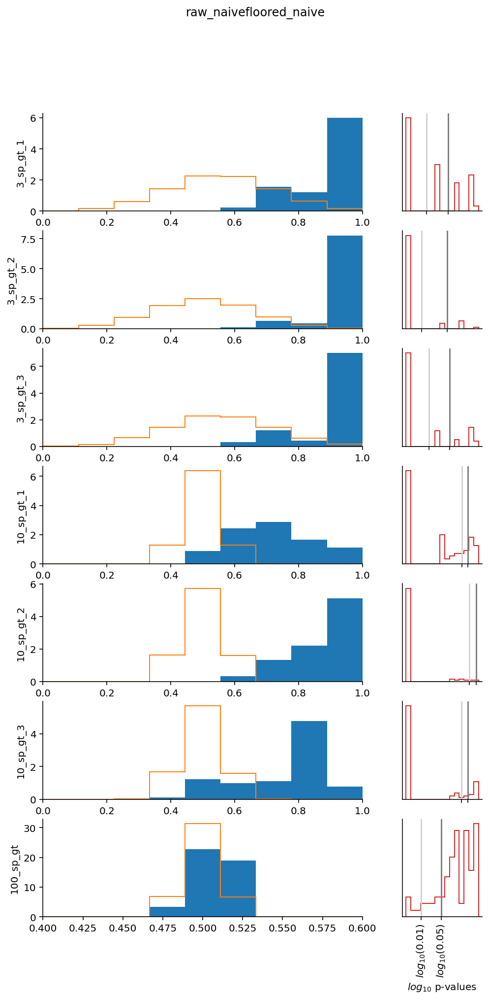

In [8]:
all_gts = [
    "3_sp_gt_1",
    "3_sp_gt_2",
    "3_sp_gt_3",
    "10_sp_gt_1",
    "10_sp_gt_2",
    "10_sp_gt_3",
    "100_sp_gt",
]

# in es, pval order
plot_order = (
    ("raw", "p_vals_naive"),
    ("floored", "p_vals_naive_floored"),
)


plot_names = [
    "raw_naive"
    "floored_naive"
]

figs = []
for (es_col, pval_col), name in zip(plot_order, plot_names):
    fig = fig_4(es_col, pval_col, name, tmp)
    figs.append(fig)